In [1]:
import pandas as pd
import re
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import nltk

nltk.download('punkt')
nltk.download('stopwords')

# 加载数据集
df = pd.read_csv('./dataset/Mozilla_bug_raw.csv', encoding='latin-1',sep='@@,,@@')

# 初始化统计字典
stop_delete = {}  # 统计被删除的停用词
frequent_delete = {}  # 统计被删除的高频和低频词
stop_words = set(stopwords.words('english'))  # 加载英文停用词

# 清理字符串的函数
def clean_str(string):
    if not isinstance(string, str):
        return ""  # 如果输入不是字符串，返回空字符串
    string = re.sub(r'[^A-Za-z0-9\s]', '', string)
    string = string.lower()
    return string

# 统计词频的字典
word_freq = {}

# 对每一列进行处理
for column in df.columns:
    for index, row in df.iterrows():
        text = clean_str(row[column])
        words = word_tokenize(text)
        for word in words:
            if word in word_freq:
                word_freq[word] += 1
            else:
                word_freq[word] = 1

# 清理文档的函数
def clean_doc(doc):
    cleaned_doc = []
    words = doc.split()
    for word in words:
        if word in stop_words:
            stop_delete[word] = stop_delete.get(word, 0) + 1
            continue
        if word_freq.get(word, 0) < 5:
            frequent_delete[word] = frequent_delete.get(word, 0) + 1
            continue
        cleaned_doc.append(word)
    return ' '.join(cleaned_doc)

# 直接更新每一列
for column in df.columns:
    df[column] = df[column].apply(lambda x: clean_doc(clean_str(x)))

# 统计每个开发者出现的次数
developer_counts = df['who'].value_counts()

# 筛选出出现次数大于10的开发者
developers_morethan10 = developer_counts[developer_counts > 10].index

# 筛选出这些开发者对应的行
filtered_rows = df[df['who'].isin(developers_morethan10)]
# 筛选出出现次数小于或等于10的开发者
developers_lessthan_or_equalto_10 = developer_counts[developer_counts <= 10]

# 打印出删除的开发者以及开发者的出现频率
print("Deleted developers and their frequencies:\n", developers_lessthan_or_equalto_10)
# 保存处理后的数据集到新的CSV文件
filtered_rows.to_csv('./dataset/Mozilla_bug_raw_processed.csv', index=False, encoding='latin-1')

# 显示删除的停用词和高低频词统计
print("Deleted stopwords:", stop_delete)
print("Deleted frequent/infrequent words:", frequent_delete)

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Administrator\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Administrator\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
C:\Users\Administrator\AppData\Local\Temp\ipykernel_35856\145083140.py:11: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  df = pd.read_csv('./dataset/Mozilla_bug_raw.csv', encoding='latin-1',sep='@@,,@@')


Deleted developers and their frequencies:
 who
edilee          10
mounir          10
aha             10
zuperdee        10
antitux         10
                ..
harty            1
steveswanson     1
valerio          1
michaelbell      1
vogt             1
Name: count, Length: 1116, dtype: int64
Deleted stopwords: {'does': 97527, 'not': 467371, 'to': 1563733, 'a': 1015141, 'after': 69049, 'of': 697770, 'the': 2636787, 'be': 435048, 'on': 586924, 'with': 357491, 'so': 187645, 'an': 161899, 'if': 380420, 'is': 874697, 'some': 105328, 'are': 214249, 'in': 973009, 'for': 615443, 'as': 365392, 's': 8834, 'when': 179233, 'no': 131115, 'before': 56274, 'that': 624239, 'at': 189479, 'between': 20403, 'by': 133381, 'it': 661861, 'will': 154682, 'during': 10150, 'where': 48591, 'down': 24057, 'only': 113032, 'all': 152928, 'too': 48608, 'and': 799059, 'under': 21401, 'do': 162286, 'because': 71328, 'from': 222990, 'or': 198973, 'we': 285534, 'have': 249039, 'they': 63835, 'been': 131077, 'than': 

In [1]:
import pandas as pd
import re
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import nltk

nltk.download('punkt')
nltk.download('stopwords')

# 加载数据集
df = pd.read_csv('./dataset/Eclipse_total.csv', encoding='latin-1')

# 初始化统计字典
stop_delete = {}  # 统计被删除的停用词
frequent_delete = {}  # 统计被删除的高频和低频词
stop_words = set(stopwords.words('english'))  # 加载英文停用词

# 清理字符串的函数
def clean_str(string):
    if not isinstance(string, str):
        return ""  # 如果输入不是字符串，返回空字符串
    string = re.sub(r'[^A-Za-z0-9\s]', '', string)
    string = string.lower()
    return string

# 统计词频的字典
word_freq = {}

# 对每一列进行处理
for column in df.columns:
    for index, row in df.iterrows():
        text = clean_str(row[column])
        words = word_tokenize(text)
        for word in words:
            if word in word_freq:
                word_freq[word] += 1
            else:
                word_freq[word] = 1

# 清理文档的函数
def clean_doc(doc):
    cleaned_doc = []
    words = doc.split()
    for word in words:
        if word in stop_words:
            stop_delete[word] = stop_delete.get(word, 0) + 1
            continue
        if word_freq.get(word, 0) < 5:
            frequent_delete[word] = frequent_delete.get(word, 0) + 1
            continue
        cleaned_doc.append(word)
    return ' '.join(cleaned_doc)

# 直接更新每一列
for column in df.columns:
    df[column] = df[column].apply(lambda x: clean_doc(clean_str(x)))

# 统计每个开发者出现的次数
developer_counts = df['developer'].value_counts()

# 筛选出出现次数大于10的开发者
developers_morethan10 = developer_counts[developer_counts > 10].index

# 筛选出这些开发者对应的行
filtered_rows = df[df['developer'].isin(developers_morethan10)]
# 筛选出出现次数小于或等于10的开发者
developers_lessthan_or_equalto_10 = developer_counts[developer_counts <= 10]

# 打印出删除的开发者以及开发者的出现频率
print("Deleted developers and their frequencies:\n", developers_lessthan_or_equalto_10)
# 保存处理后的数据集到新的CSV文件
filtered_rows.to_csv('./processed_data/Eclipse_total_processed.csv', index=False, encoding='latin-1')

# 显示删除的停用词和高低频词统计
print("Deleted stopwords:", stop_delete)
print("Deleted frequent/infrequent words:", frequent_delete)

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Administrator\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Administrator\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Deleted developers and their frequencies:
 developer
djohnson           10
debbiewilson       10
unknown2           10
samratdhillon      10
socgeneralinbox    10
                   ..
pinnamur            1
allangodding        1
jansievers          1
wajnberg            1
fchouinard          1
Name: count, Length: 349, dtype: int64
Deleted stopwords: {'i': 8310, 'd': 3562, 'o': 1104, 'in': 5823, 've': 4337, 't': 1806, 'ma': 89, 'y': 229, 'a': 3538, 'and': 1632, 'about': 925, 're': 1444, 's': 8460, 'on': 295, 'same': 28, 'do': 235, 'of': 140, 'to': 417, 'not': 164, 'if': 308, 'so': 316, 'for': 222, 'up': 489, 'm': 8137, 'off': 188, 'by': 84, 'how': 51, 'out': 949, 'more': 18, 'no': 295, 'down': 228, 'or': 288, 'am': 293, 'me': 308, 'own': 132, 'this': 496, 'before': 131, 'all': 264, 'll': 1347, 'as': 120, 'you': 42, 'at': 105, 'should': 39, 'any': 17, 'doesn': 24, 'does': 16, 'some': 68, 'other': 91, 'are': 17, 'over': 22, 'its': 18, 'can': 44, 'most': 20, 'too': 6, 'don': 101, 'with': 

In [2]:
import pandas as pd
import re
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import nltk

# nltk.download('punkt')
# nltk.download('stopwords')

# 加载数据集
df = pd.read_csv('./dataset2/jdt_data.csv', encoding='latin-1',)

# # 初始化统计字典
# stop_delete = {}  # 统计被删除的停用词
# frequent_delete = {}  # 统计被删除的高频和低频词
# stop_words = set(stopwords.words('english'))  # 加载英文停用词

# # 清理字符串的函数
# def clean_str(string):
#     if not isinstance(string, str):
#         return ""  # 如果输入不是字符串，返回空字符串
#     string = re.sub(r'[^A-Za-z0-9\s]', '', string)
#     string = string.lower()
#     return string

# # 统计词频的字典
# word_freq = {}

# # 对每一列进行处理
# for column in df.columns:
#     for index, row in df.iterrows():
#         text = clean_str(row[column])
#         words = word_tokenize(text)
#         for word in words:
#             if word in word_freq:
#                 word_freq[word] += 1
#             else:
#                 word_freq[word] = 1

# # 清理文档的函数
# def clean_doc(doc):
#     cleaned_doc = []
#     words = doc.split()
#     for word in words:
#         if word in stop_words:
#             stop_delete[word] = stop_delete.get(word, 0) + 1
#             continue
#         if word_freq.get(word, 0) < 5:
#             frequent_delete[word] = frequent_delete.get(word, 0) + 1
#             continue
#         cleaned_doc.append(word)
#     return ' '.join(cleaned_doc)

# # 直接更新每一列
# for column in df.columns:
#     df[column] = df[column].apply(lambda x: clean_doc(clean_str(x)))

# # 统计每个开发者出现的次数
developer_counts = df['Assignee'].value_counts()

# 筛选出出现次数大于10的开发者
developers_morethan10 = developer_counts[developer_counts > 15].index

# 筛选出这些开发者对应的行
filtered_rows = df[df['Assignee'].isin(developers_morethan10)]
# 筛选出出现次数小于或等于10的开发者
developers_lessthan_or_equalto_15 = developer_counts[developer_counts <= 15]

# 打印出删除的开发者以及开发者的出现频率
print("Deleted developers and their frequencies:\n", developers_lessthan_or_equalto_15)
# 保存处理后的数据集到新的CSV文件
filtered_rows.to_csv('./dataset2/jdt_data_processed2.csv', index=False, encoding='latin-1')

# # 显示删除的停用词和高低频词统计
# print("Deleted stopwords:", stop_delete)
# print("Deleted frequent/infrequent words:", frequent_delete)

Deleted developers and their frequencies:
 Assignee
jesper                 14
eclipse                13
sptaszkiewicz          11
anchakrk               11
jdt-ui-inbox           10
david_williams         10
samrat.dhillon         10
aclement                8
het                     8
darin.eclipse           7
mistria                 7
akurtakov               6
philippe_mulet          5
ma.becker               5
amj87.iitr              5
loskutov                5
frederic_fusier         4
eclipse.sprigogin       4
nikolaymetchev          4
kent_johnson            4
jan.rosczak             3
hanke                   3
jerome.cambon           3
marcel.bruch            2
pisv                    2
jerome_lanneluc         2
tmccrary                2
thanh.ha                2
yves.joan               2
tomasz.zarna            2
jared_burns             2
mat.booth               2
alex.blewitt            2
novanic                 1
stefan.ocke             1
jens.schiebel           1
kalyan_prasa

In [7]:
# 读取CSV文件
import pandas as pd
df = pd.read_csv('./dataset/bug_raw.csv', encoding='latin-1', sep='@@,,@@')

# 统计'who'列中不同开发者的种类数
unique_developers_count = df['who'].nunique()

print("不同开发者的种类数:", unique_developers_count)

不同开发者的种类数: 1022


In [12]:
# 读取CSV文件
import pandas as pd
df = pd.read_csv('./dataset/Mozilla_total.csv', encoding='latin-1')

# 将每一行的所有列合并为一个字符串，并计算每一行的单词数量
df['word_count'] = df.apply(lambda x: len(' '.join(x.dropna().astype(str)).split()), axis=1)

# 找到单词数量最多的那一行
max_word_count_row = df.loc[df['word_count'].idxmax()]

print("单词数量最多的行的内容：")
print(max_word_count_row)
print("最多单词数量：", max_word_count_row['word_count'])

单词数量最多的行的内容：
bug_id                                                    424833
product                                           Cloud Services
abstracts                                     client synchronis 
description    updat weav stop synchronis manual tinker reset...
component                                                General
severity                                                  normal
priority                                                      --
developer                                                 nobody
history                               dtownsend thunder thunder 
status                                                     FIXED
word_count                                                  5075
Name: 3930, dtype: object
最多单词数量： 5075


In [4]:
import csv
import json

# 指定CSV文件路径和输出的JSON文件路径
csv_file_path = './dataset/Eclipse_total_processed_jump_final_deleted_lowdeveloper_again.csv'
json_file_path = './json/output.json'

# 读取CSV文件
with open(csv_file_path, mode='r', encoding='utf-8') as csv_file:
    csv_reader = csv.DictReader(csv_file)
    data_list = []

    # 处理每一行数据
    for row in csv_reader:
        # 合并description和abstract字段为content
        content = f"{row['description']} {row['abstracts']}"
        # 使用developer字段作为summary
        ziduan = 'can fix this bug' 
        summary = row['developer'] + " "+ziduan
        
        # 构建新的字典并添加到列表中
        data_list.append({'content': content, 'summary': summary})

# 写入JSON文件
with open(json_file_path, 'w', encoding='utf-8') as json_file:
    json.dump(data_list, json_file, ensure_ascii=False, indent=4)

In [6]:
import csv
import json
from collections import defaultdict

# 指定CSV文件路径和输出的JSON文件路径
csv_file_path = './dataset/Eclipse_total_processed_jump_final_deleted_lowdeveloper_again.csv'
train_json_path = './json/train.json'
dev_json_path = './json/dev.json'

# 读取CSV文件
with open(csv_file_path, mode='r', encoding='utf-8') as csv_file:
    csv_reader = csv.DictReader(csv_file)
    developer_entries = defaultdict(list)

    # 处理每一行数据
    for row in csv_reader:
        # 合并description和abstract字段为content
        content = f"{row['description']} {row['abstracts']}"
        # 使用developer字段作为summary
        ziduan = 'can fix this bug'
        summary = row['developer'] + " " + ziduan
        
        # 构建新的字典并添加到列表中
        entry = {'content': content, 'summary': summary}
        developer_entries[row['developer']].append(entry)

# 打印开发者的出现频率
for developer, entries in developer_entries.items():
    print(f"Developer {developer} appears {len(entries)} times.")

# 选择每个开发者的一条记录放入dev.json，其余放入train.json
train_data = []
dev_data = []

for developer, entries in developer_entries.items():
    # 将第一条记录放入dev.json
    dev_data.append(entries[0])
    # 将剩余记录放入train.json
    train_data.extend(entries[1:])

# 写入train.json文件
with open(train_json_path, 'w', encoding='utf-8') as json_file:
    for data in train_data:
        json_file.write(json.dumps(data, ensure_ascii=False) + '\n')

# 写入dev.json文件
with open(dev_json_path, 'w', encoding='utf-8') as json_file:
    for data in dev_data:
        json_file.write(json.dumps(data, ensure_ascii=False) + '\n')

Developer gabeobrien appears 34 times.
Developer portalinbox appears 183 times.
Developer bjornfreemanbenson appears 89 times.
Developer wayne appears 50 times.
Developer matt appears 11 times.
Developer karlmatthias appears 23 times.
Developer webmaster appears 1424 times.
Developer emo appears 204 times.
Developer thanhha appears 16 times.
Developer caniszczyk appears 310 times.
Developer gunnar appears 32 times.
Developer planeteclipseadmininbox appears 42 times.
Developer phoenixuiinbox appears 395 times.
Developer denisroy appears 56 times.
Developer chrisguindon appears 12 times.
Developer davidwilliams appears 454 times.
Developer sleeloy appears 57 times.
Developer sadravid appears 22 times.
Developer jagmits appears 34 times.
Developer leonardrichardson appears 10 times.
Developer joelhawkins appears 11 times.
Developer hkyleung appears 40 times.
Developer williammuldoon appears 13 times.
Developer toddsing appears 13 times.
Developer amehrega appears 45 times.
Developer dlwhi

In [6]:
import pandas as pd
import numpy as np

# 定义一个函数来计算文件中每一行的统计数据
def calculate_statistics(file_path):
    df = pd.read_csv(file_path, encoding='latin-1')
    # 将每一行的所有列合并为一个字符串
    merged_texts = df.apply(lambda x: ' '.join(x.dropna().astype(str)), axis=1)
    # 计算每一行的字符长度
    lengths = merged_texts.apply(len)
    # 计算平均长度、最小长度、最大长度和中位数
    avg_length = np.mean(lengths)
    min_length = np.min(lengths)
    max_length = np.max(lengths)
    median_length = np.median(lengths)
    return avg_length, min_length, max_length, median_length

# 指定文件路径
files = ['./dataset/Mozilla_total.csv', './dataset/Mozilla_morethan10_processed_again.csv']

# 对每个文件进行统计
for file in files:
    avg_length, min_length, max_length, median_length = calculate_statistics(file)
    print(f"Statistics for {file}:")
    print(f"Average Length: {avg_length}")
    print(f"Minimum Length: {min_length}")
    print(f"Maximum Length: {max_length}")
    print(f"Median Length: {median_length}\n")

Statistics for ./dataset/Mozilla_total.csv:
Average Length: 503.52695152450383
Minimum Length: 75
Maximum Length: 32416
Median Length: 355.0

Statistics for ./dataset/Mozilla_morethan10_processed_again.csv:
Average Length: 450.7081068305365
Minimum Length: 45
Maximum Length: 30393
Median Length: 313.0



In [ ]:

1. **截断（Truncation）**：当文本长度超过模型的最大长度时，保留前N个token，丢弃超出部分。这是最简单的处理方式，但可能会丢失重要信息。

2. **滑动窗口（Sliding Window）**：将文本分成多个部分，每个部分有一定的重叠。这样可以保留更多的信息，但会增加处理时间和复杂度。

3. **分段处理（Chunking）**：将文本分成多个段落或句子，分别处理每个部分。这种方法适用于文本自然分段明显的情况。

4. **注意力掩码（Attention Masking）**：在某些情况下，可以通过设计特殊的注意力掩码来让模型只关注部分token，从而间接处理超长文本。


5. **跳跃采样（Skip Sampling）**：对于超过长度的文本，通过跳过一些token来减少总长度，如每隔一个词取一个词。

In [ ]:
对description列进行处理 我们这里采用一种跳跃采用把token维持在256到512 低于256直接删除

In [7]:
from transformers import BertTokenizer
import pandas as pd
import numpy as np
from tqdm.auto import tqdm  # 导入tqdm

# 加载BERT分词器
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

def batch_adjust_token_length(texts, lower_limit=256, upper_limit=512):
    # 将文本批量编码
    encoding = tokenizer(texts.tolist(), add_special_tokens=True, padding=True, truncation=False, return_tensors="pt", max_length=None)
    input_ids = encoding['input_ids']
    adjusted_texts = []
    
    for tokens in input_ids:
        length = len(tokens)
        if length < lower_limit:
            adjusted_texts.append(None)  # token数量低于下限，标记为删除
            continue
        
        # 如果token数量超过upper_limit，通过跳跃采样减少token数量
        while length > upper_limit:
            # 如果长度超过上限的两倍，则通过跳跃采样减少token数量
            if length > 2 * upper_limit:
                # 通过跳跃采样减少token数量，确保最终长度接近但不超过upper_limit
                step = length // upper_limit
                tokens = tokens[::step]
            else:
                # 如果长度没有超过上限的两倍，但仍然超过上限，则每隔一个token取一个
                tokens = tokens[::2]
            length = len(tokens)
        adjusted_text = tokenizer.decode(tokens, skip_special_tokens=True)
        adjusted_texts.append(adjusted_text)
    
    return adjusted_texts

# 读取CSV文件
df = pd.read_csv('./dataset/bug_raw.csv', encoding='latin-1', sep='@@,,@@')

# 确保description列中的所有数据都是字符串类型
df['description'] = df['description'].astype(str)

# 应用批量调整token长度的函数
# 注意：根据你的数据集大小，你可能需要将数据分批处理
batch_size = 1  # 或者根据你的内存大小调整
results = []

# 使用tqdm显示进度条
for start in tqdm(range(0, df.shape[0], batch_size), desc="Processing"):
    end = start + batch_size
    batch_texts = df['description'][start:end]
    batch_results = batch_adjust_token_length(batch_texts)
    results.extend(batch_results)

df['description'] = results

# 删除description为None的行
df.dropna(subset=['description'], inplace=True)

# 保存处理后的数据集到新的CSV文件
df.to_csv('./dataset/bug_raw_processed_new.csv', index=False, encoding='latin-1')

C:\Users\Administrator\AppData\Local\Temp\ipykernel_18260\1631327352.py:38: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  df = pd.read_csv('./dataset/bug_raw.csv', encoding='latin-1', sep='@@,,@@')


Processing:   0%|          | 0/199960 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (1238 > 512). Running this sequence through the model will result in indexing errors


1. 词汇表大小：不同的tokenizer有不同的词汇表大小。例如，BERT模型的tokenizer词汇表大小为30522，而GPT-2的tokenizer词汇表大小则为50257。词汇表的大小直接影响了模型能够理解和生成的词汇范围。
2. 分词机制：不同的tokenizer采用不同的分词机制。例如，BERT使用WordPiece算法进行分词，而GPT-2使用Byte Pair Encoding（BPE）算法。这些分词机制决定了如何将原始文本拆分成模型能够理解的token。
3. 特殊token：不同的tokenizer可能会使用不同的特殊token，如开始token（[CLS]、[BOS]等）、结束token（[SEP]、[EOS]等）和未知词token（[UNK]）。这些特殊token在模型训练和推理中扮演重要角色。
4. 预处理和后处理：tokenizer在对文本进行编码（预处理）和解码（后处理）时，可能会采用不同的规则和方法，如是否添加特殊token、如何处理过长文本等。
因此，在使用特定的预训练模型进行文本处理时，需要使用与该模型匹配的tokenizer，以确保文本能够正确地被模型理解和处理。这也意味着在迁移到不同的模型时，可能需要调整文本处理流程，以适应新模型的tokenizer特性。

In [3]:
# 进度条版本
from transformers import BertTokenizer
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm

# 加载BERT分词器
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

def calculate_bert_token_statistics_and_plot(file_path, sep=','):
    df = pd.read_csv(file_path, encoding='latin-1', sep=sep)
    # 统计行数
    num_rows = df.shape[0]
    print(f"Number of rows in {file_path}: {num_rows}")
    
    # 确保description列中的所有数据都是字符串类型
    df['description'] = df['description'].astype(str).fillna('')
    
    # 使用BERT分词器对description列进行分词，并计算每个文本的token数量
    # 使用tqdm显示进度条
    token_lengths = []
    for desc in tqdm(df['description'], desc="Tokenizing"):
        tokens = tokenizer.encode(desc, add_special_tokens=True)
        token_lengths.append(len(tokens))
    
    # 计算平均长度、最小长度、最大长度和中位数
    token_lengths = pd.Series(token_lengths)  # 转换为pandas序列以利用统计函数
    avg_length = token_lengths.mean()
    min_length = token_lengths.min()
    max_length = token_lengths.max()
    median_length = token_lengths.median()
    
    # 绘制token数分布图
    plt.figure(figsize=(10, 6))
    plt.hist(token_lengths, bins=50, alpha=0.7)
    plt.title(f'Token Length Distribution in {file_path}')
    plt.xlabel('Token Length')
    plt.ylabel('Frequency')
    plt.show()
    
    return avg_length, min_length, max_length, median_length, num_rows
# 指定文件路径
files = ['./dataset/bug_raw_processed_filtered.csv']

# 对每个文件进行统计和绘图
for file in files:
    if 'bug_raw.csv' in file:
        sep = '@@,,@@'  # 对于第一个文件使用特定分隔符
    else:
        sep = ','  # 对于其他文件使用默认分隔符
    avg_length, min_length, max_length, median_length, num_rows = calculate_bert_token_statistics_and_plot(file, sep)
    print(f"BERT Token Statistics for {file}:")
    print(f"Number of Rows: {num_rows}")
    print(f"Average Token Length: {avg_length}")
    print(f"Minimum Token Length: {min_length}")
    print(f"Maximum Token Length: {max_length}")
    print(f"Median Token Length: {median_length}\n")

Number of rows in ./dataset/bug_raw_processed_filtered.csv: 127124


Tokenizing:   4%|▎         | 4461/127124 [00:34<15:43, 129.99it/s]


KeyboardInterrupt: 

In [8]:
#人名标签分布
from transformers import BertTokenizer
import pandas as pd
import matplotlib.pyplot as plt

def plot_who_frequency(file_path, sep=','):
    df = pd.read_csv(file_path, encoding='latin-1', sep=sep)
    # 统计`who`列中每个人名出现的次数
    who_frequency = df['who'].value_counts()
    
    # 绘制人名出现频率的图表
    plt.figure(figsize=(10, 6))
    who_frequency.plot(kind='bar')
    plt.title(f'Frequency of Names in {file_path}')
    plt.xlabel('Names')
    plt.ylabel('Frequency')
    plt.xticks(rotation=45)  # 旋转x轴标签，以便更清楚地显示
    plt.show()

# 指定文件路径
files = ['./dataset/bug_raw.csv', './dataset/bug_raw_processed.csv']

# 对每个文件进行统计和绘图
for file in files:
    if 'bug_raw.csv' in file:
        sep = '@@,,@@'  # 对于第一个文件使用特定分隔符
    else:
        sep = ','  # 对于其他文件使用默认分隔符
    plot_who_frequency(file, sep)

In [1]:
import pandas as pd

# 读取CSV文件
df = pd.read_csv('./dataset/bug_raw_processed_new.csv', encoding='latin-1')

# 统计`who`列中每个人名出现的频率
who_frequency = df['who'].value_counts()

# 对频率进行升序排序
who_frequency_sorted = who_frequency.sort_values()

# 打印排序后的频率
print(who_frequency_sorted)

who
sdix@atdesk.com                         1
phyo.kyaw@dur.ac.uk                     1
Julien.GOUESSE@tech-advantage.com       1
olaf@x100.de                            1
athena@webtide.com                      1
                                     ... 
aeschli@gmail.com                    1568
steffen.pingel@tasktop.com           1571
Olivier_Thomann@ca.ibm.com           1575
daniel_megert@ch.ibm.com             2476
darin.eclipse@gmail.com              2510
Name: count, Length: 2845, dtype: int64


In [2]:
import pandas as pd

# 读取CSV文件
df = pd.read_csv('./dataset/bug_raw_processed_new.csv', encoding='latin-1')

# 统计`who`列中每个人名出现的频率
who_frequency = df['who'].value_counts()

# 找出频率大于或等于10的人名
who_valid = who_frequency[who_frequency >= 10].index

# 过滤掉`who`列中频率低于10的行
df_filtered = df[df['who'].isin(who_valid)]

# 保存过滤后的DataFrame到新的CSV文件
df_filtered.to_csv('./dataset/bug_raw_processed_filtered.csv', index=False, encoding='latin-1')

# 打印过滤后的`who`列中每个人名出现的频率，确认过滤效果
who_frequency_filtered = df_filtered['who'].value_counts()
print(who_frequency_filtered.sort_values())

who
digulla@hepe.com                10
yunan.he@intel.com              10
jvincens@us.ibm.com             10
Tod_Creasey                     10
lonnie@pryor.us.com             10
                              ... 
aeschli@gmail.com             1568
steffen.pingel@tasktop.com    1571
Olivier_Thomann@ca.ibm.com    1575
daniel_megert@ch.ibm.com      2476
darin.eclipse@gmail.com       2510
Name: count, Length: 890, dtype: int64


In [5]:
from transformers import BertTokenizer
import pandas as pd
import matplotlib.pyplot as plt

# 加载BERT分词器
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# 读取数据集
df = pd.read_csv('./dataset/dataprocessed_description_creative_processed.csv', encoding='latin-1')

# 使用BERT分词器对description列进行分词，并计算每个文本的token数量
# 在应用encode方法之前，先将nan值替换为空字符串
token_lengths = df['description'].astype(str).fillna('').apply(lambda x: len(tokenizer.encode(x, add_special_tokens=True)))
# 计算中位数、最大值和最小值
median_length = token_lengths.median()
max_length = token_lengths.max()
min_length = token_lengths.min()

print(f"Median token length: {median_length}")
print(f"Maximum token length: {max_length}")
print(f"Minimum token length: {min_length}")


Token indices sequence length is longer than the specified maximum sequence length for this model (683 > 512). Running this sequence through the model will result in indexing errors


Median token length: 592.0
Maximum token length: 20636
Minimum token length: 258


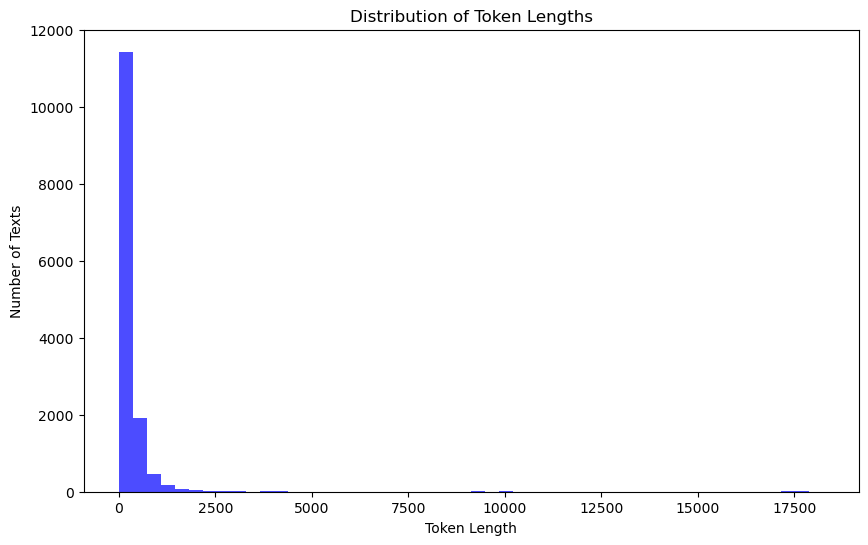

In [4]:
# 绘制直方图
plt.figure(figsize=(10, 6))
plt.hist(token_lengths, bins=50, color='blue', alpha=0.7)
plt.title('Distribution of Token Lengths')
plt.xlabel('Token Length')
plt.ylabel('Number of Texts')
plt.show()